In [42]:
#Not all these packages are required but they are here for completeness
import importlib
import io
import matplotlib.pyplot as plt
import numpy as np
import os
import openslide
from openslide import open_slide
from pathlib import Path
import pandas as pd
from PIL import Image, ImageOps, ImageChops, ImageDraw
import SimpleITK as sitk
from skimage.color import rgb2hed
from skimage.filters import threshold_otsu
from skimage.morphology import remove_small_holes
from skimage.util import apply_parallel
import staintools
from staintools.stain_extraction.macenko_stain_extractor import MacenkoStainExtractor
from staintools.stain_extraction.vahadane_stain_extractor import VahadaneStainExtractor
from staintools.miscellaneous.optical_density_conversion import convert_OD_to_RGB
from staintools.miscellaneous.get_concentrations import get_concentrations
import cv2 as cv
from staintools.preprocessing.input_validation import is_uint8_image
import sys


Image.MAX_IMAGE_PIXELS = None

In [28]:
# Import package 
print(sys.executable) 

BASE_DIR = Path().resolve()
HEMNET_DIR = BASE_DIR.parent.joinpath('HEMnet')

sys.path.append(str(HEMNET_DIR))

print(os.getcwd())

from slide import *
from utils import *
from normaliser import *

/gpfs1/scratch/90days/s4436005/envs/bin/python
/gpfs1/homes/s4436005/HEMnet/Development


In [8]:
from staintools import stain_normalizer
from staintools import LuminosityStandardizer as LS

In [30]:
import utils
importlib.reload(utils)
from utils import *

import slide
importlib.reload(slide)
from slide import *

import normaliser
importlib.reload(normaliser)
from normaliser import *

In [4]:
# User Input parameters
SLIDES_PATH = Path('/gpfs1/scratch/90days/s4436005/')
#OUTPUT_PATH = Path('/gpfs1/scratch/90days/s4436005/img_reg/train_dataset_10x_11_12_19_v3')
OUTPUT_PATH = Path('/gpfs1/scratch/90days/s4436005/img_reg/17_12_19_testing')
TEMPLATE_SLIDE_PATH = Path('/gpfs1/scratch/90days/s4436005/2171_T_11524A_2_HandE.svs')


ALIGNMENT_MAG = 1
TILE_MAG = 5
VERBOSE = True

#Verbose functions
if VERBOSE:
    verbose_print = lambda *args: print(*args)
    verbose_save_img = lambda img, path, img_type: img.save(path, img_type)
    verbose_save_fig = lambda fig, path, dpi=300: fig.savefig(path, dpi=dpi)
else:
    verbose_print = lambda *args: None
    verbose_save_img = lambda *args: None
    verbose_save_fig = lambda *args: None

# Find Slides
slides = []
for slide in SLIDES_PATH.glob('*.svs'):
    name = slide.name
    slides.append(name)
slides.sort()
slides

['1820_N_10545A_2_HandE.svs',
 '1820_N_10545A_4_TP53.svs',
 '1820_T_105452F_2_HandE.svs',
 '1820_T_105452F_4_TP53.svs',
 '2065_N_12752A_2_HandE.svs',
 '2065_N_12752A_4_TP53.svs',
 '2065_T_12756A_2_HandE.svs',
 '2065_T_12756A_4_TP53.svs',
 '2112_N_12341B_2_HandE.svs',
 '2112_N_12341B_4_TP53.svs',
 '2112_T_12335F_2_HandE.svs',
 '2112_T_12335F_4_TP53.svs',
 '2148_N_11397A_2_HandE.svs',
 '2148_N_11397A_4_TP53.svs',
 '2148_T_11393A_2_HandE.svs',
 '2148_T_11393A_4_TP53.svs',
 '2171_N_11521A_2_HandE.svs',
 '2171_N_11521A_4_TP53.svs',
 '2171_T_11524A_2_HandE.svs',
 '2171_T_11524A_4_TP53.svs']

In [5]:
TP53_slides = [slide for slide in slides if 'TP53' in slide]
HE_slides = [slide for slide in slides if 'HandE' in slide]
Paired_slides = list(zip(TP53_slides, HE_slides))
Paired_slides

[('1820_N_10545A_4_TP53.svs', '1820_N_10545A_2_HandE.svs'),
 ('1820_T_105452F_4_TP53.svs', '1820_T_105452F_2_HandE.svs'),
 ('2065_N_12752A_4_TP53.svs', '2065_N_12752A_2_HandE.svs'),
 ('2065_T_12756A_4_TP53.svs', '2065_T_12756A_2_HandE.svs'),
 ('2112_N_12341B_4_TP53.svs', '2112_N_12341B_2_HandE.svs'),
 ('2112_T_12335F_4_TP53.svs', '2112_T_12335F_2_HandE.svs'),
 ('2148_N_11397A_4_TP53.svs', '2148_N_11397A_2_HandE.svs'),
 ('2148_T_11393A_4_TP53.svs', '2148_T_11393A_2_HandE.svs'),
 ('2171_N_11521A_4_TP53.svs', '2171_N_11521A_2_HandE.svs'),
 ('2171_T_11524A_4_TP53.svs', '2171_T_11524A_2_HandE.svs')]

In [6]:
#Load and fit template slide
template_slide = open_slide(str(TEMPLATE_SLIDE_PATH))
template = read_slide_at_mag(template_slide, ALIGNMENT_MAG)

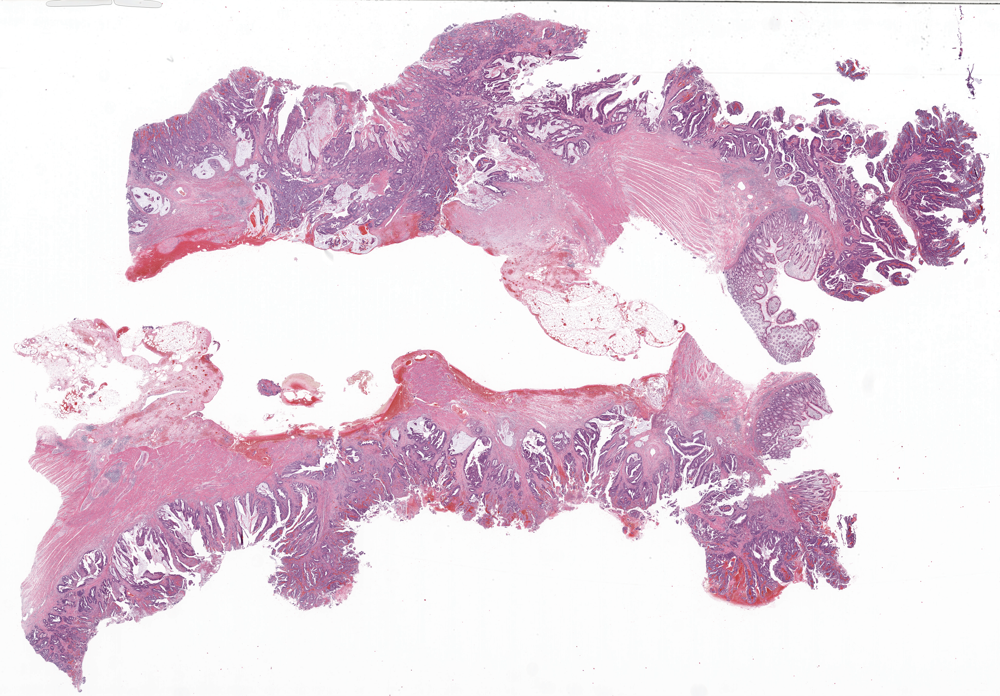

In [39]:
normaliser = StainNormalizerIterative(method='vahadane')
normaliser_og = staintools.StainNormalizer(method='vahadane')
template_std = LuminosityStandardizerIterative.standardize(np.array(template))
template_std_og = LS.standardize(np.array(template))
normaliser.fit(template_std)
normaliser_og.fit(template_std_og)
thumbnail(Image.fromarray(template_std))

In [12]:
template_tile_mag = read_slide_at_mag(template_slide, TILE_MAG)
normaliser_tile_mag = StainNormalizer(method='vahadane')
template_std_tile_mag = LuminosityStandardizer.standardize(np.array(template_tile_mag))
normaliser_tile_mag.fit(template_std_tile_mag)

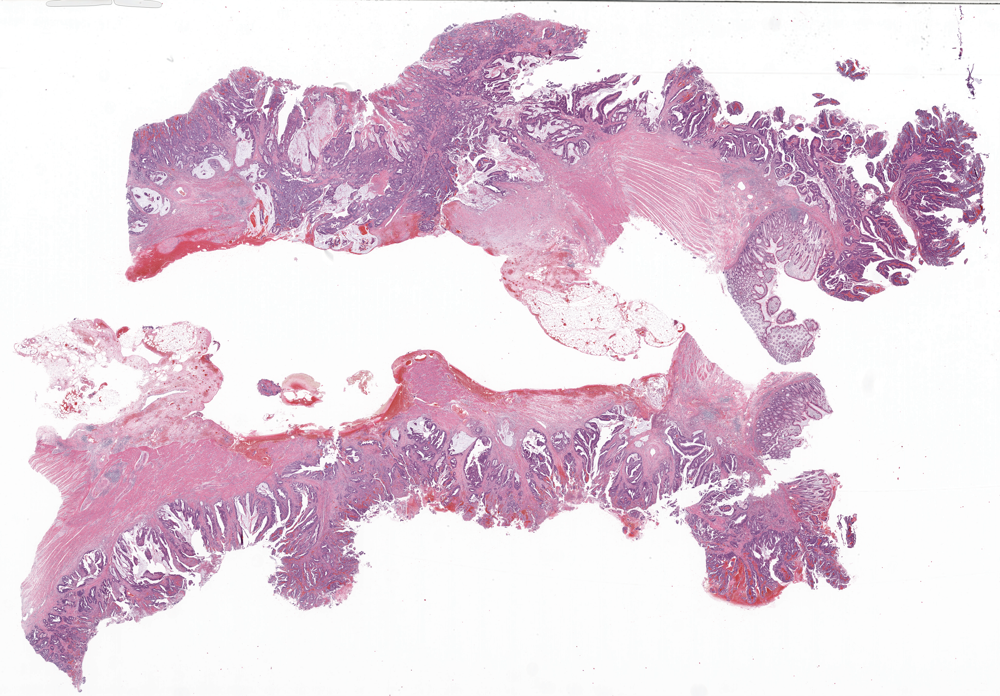

In [10]:
thumbnail(Image.fromarray(template_std_og))

In [11]:
SLIDE_NUM = 0
PREFIX = Paired_slides[SLIDE_NUM][0][:-8]
verbose_print('Processing Slide: {0}'.format(PREFIX))
tp53_name, he_name = Paired_slides[SLIDE_NUM]
tp53_slide = open_slide(str(SLIDES_PATH.joinpath(tp53_name)))
he_slide = open_slide(str(SLIDES_PATH.joinpath(he_name)))

Processing Slide: 1820_N_10545A_4_


In [12]:
#Load Slides
he = read_slide_at_mag(he_slide, ALIGNMENT_MAG)
tp53 = read_slide_at_mag(tp53_slide, ALIGNMENT_MAG)

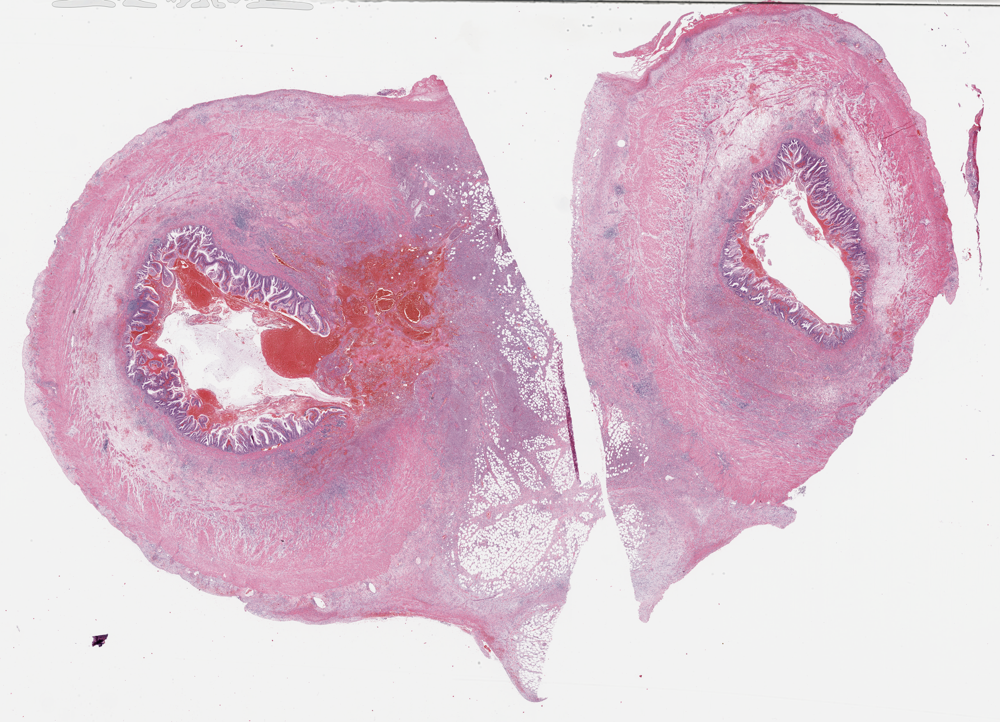

In [13]:
thumbnail(he)

In [50]:
#Normalise H&E Slide
he_std = LuminosityStandardizerIterative.standardize(np.array(he))
he_std_og = LS.standardize(np.array(he))
he_transformed = normaliser.transform_tile(he_std)
he_transformed_og = normaliser_og.transform(he_std_og)
he_norm_small = Image.fromarray(he_transformed)
he_norm_small_og = Image.fromarray(he_transformed_og)

In [56]:
he_std.shape

(2014, 2789, 3)

In [57]:
he_transformed.shape

(2014, 2789, 3)

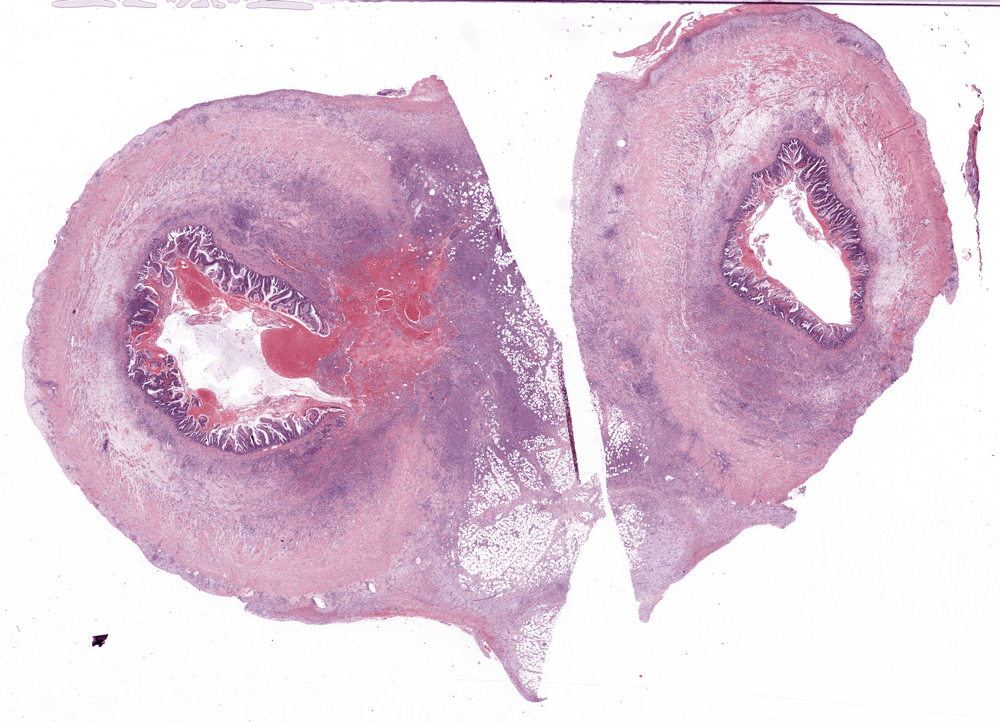

In [51]:
thumbnail(he_norm_small)

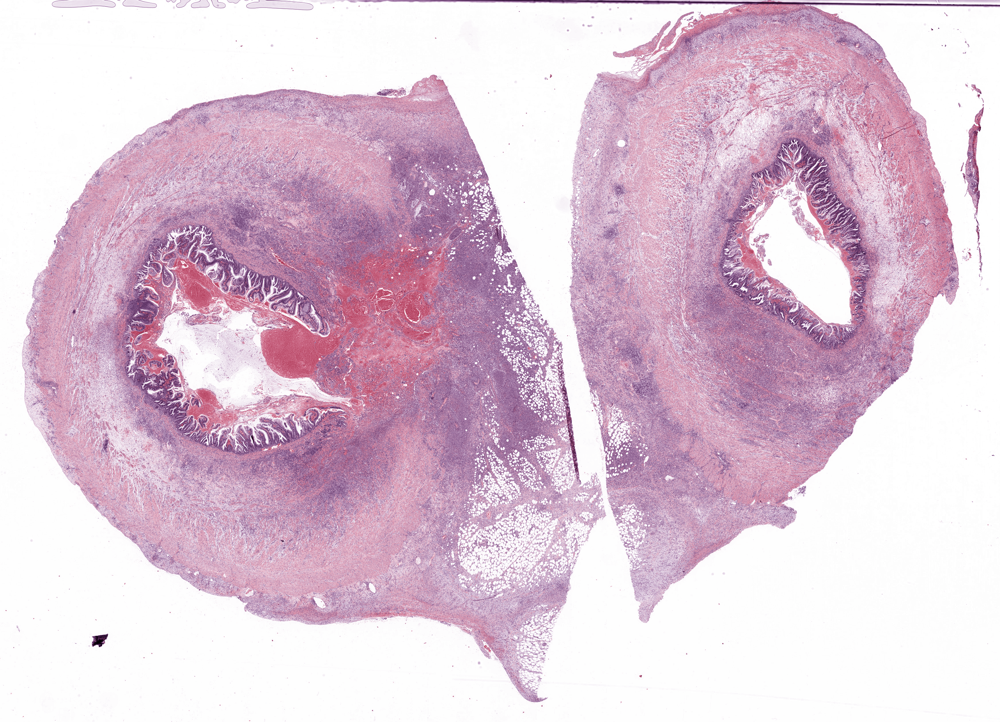

In [52]:
thumbnail(he_norm_small_og)

### Compare iterative tile normalisation to whole-slide normalisation

In [41]:
#Fit Lumosity Standardizer and Normaliser to source image
LumStd = LuminosityStandardizerIterative()
LumStd.fit(np.array(he.convert('RGB')))
normaliser.fit_source(np.array(he_std))

In [67]:
std_and_norm = lambda x: normaliser.transform_tile(LumStd.standardize_tile(x)) if x.shape==(299,299,3) else x

In [68]:
iternormed = apply_parallel(std_and_norm, np.array(he.convert('RGB')), chunks = (299, 299,3))

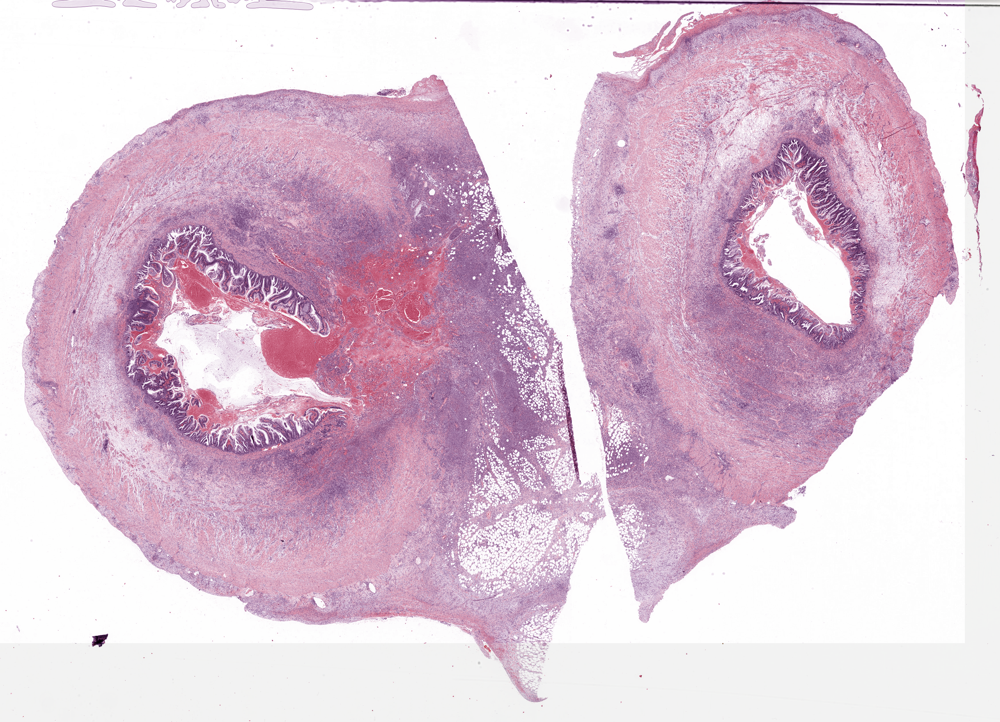

In [69]:
Image.fromarray(iternormed)

In [17]:
tile_size = 299*ALIGNMENT_MAG/TILE_MAG

In [35]:
LumStd = LuminosityStandardizerIterative()
LumStd.fit(np.array(he.convert('RGB')))
normaliser.fit_source(np.array(he_std))
tgen = tile_gen_at_mag(he_slide, TILE_MAG, 299)

In [36]:
tgen = tile_gen_at_mag(he_slide, TILE_MAG, 299)
tgen_small = tile_gen(he_norm_small, tile_size)
tgen_small_og = tile_gen(he_norm_small, tile_size)

In [23]:
tiles_mag = []
tiles_small = []
tiles_small_og = []
for i in range(200):
    tiles_mag.append(next(tgen))
    tiles_small.append(next(tgen_small))
    tiles_small_og.append(next(tgen_small_og))

In [37]:
he_tile_mag = read_slide_at_mag(he_slide, TILE_MAG)
he_std_tile_mag = LuminosityStandardizer.standardize(np.array(he_tile_mag))
he_transformed_tile_mag = normaliser.transform(he_std_tile_mag)
he_norm_tile_mag = Image.fromarray(he_transformed_tile_mag)

In [38]:
thumbnail(Image.fromarray(normaliser_tile_mag.transform(he_std_tile_mag)))

NameError: name 'normaliser_tile_mag' is not defined

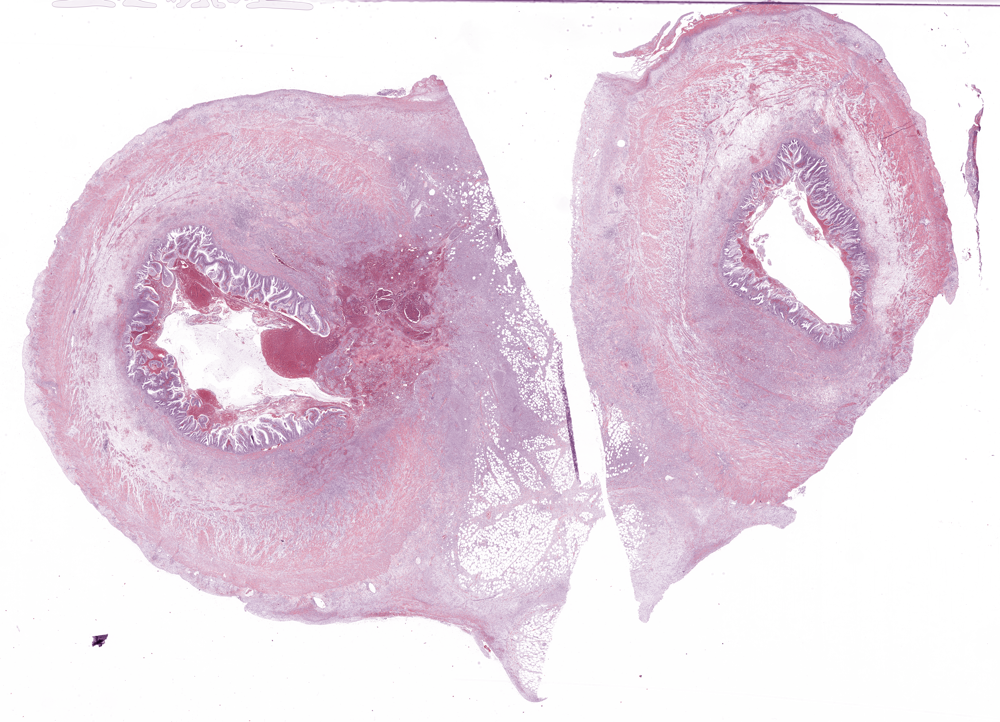

In [26]:
thumbnail(he_norm_tile_mag)

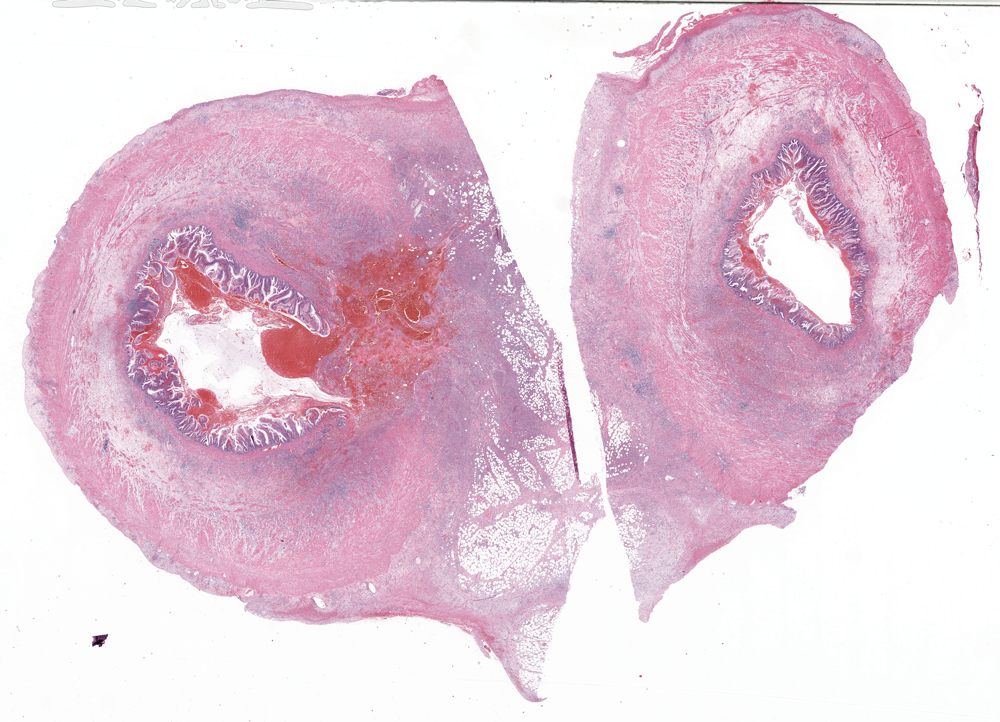

In [27]:
thumbnail(Image.fromarray(he_std_tile_mag))

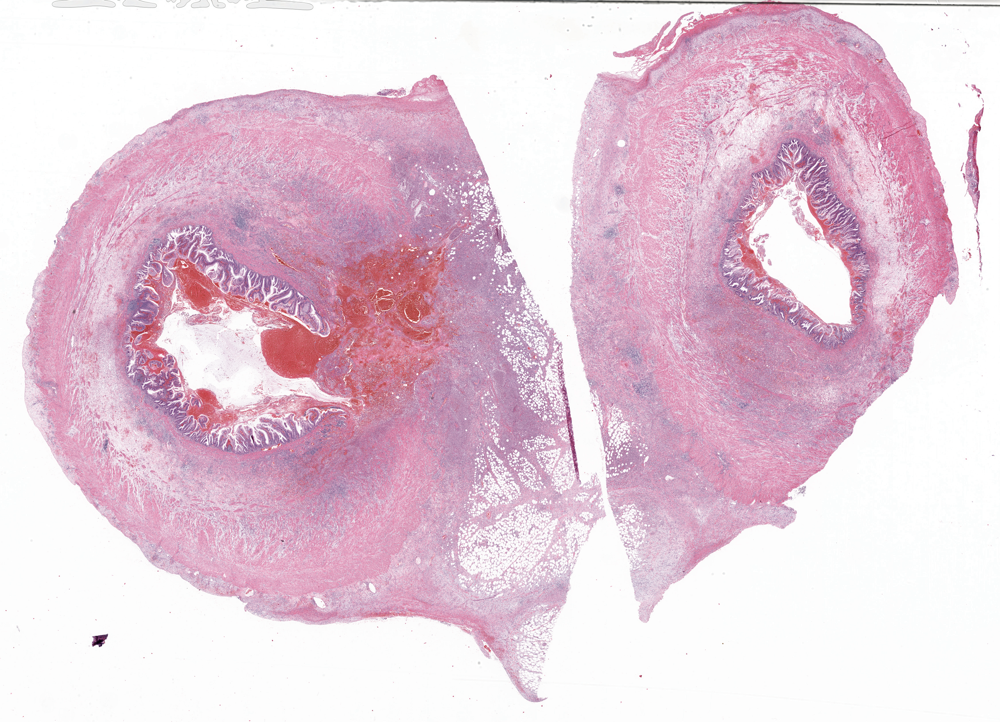

In [28]:
thumbnail(Image.fromarray(he_std))

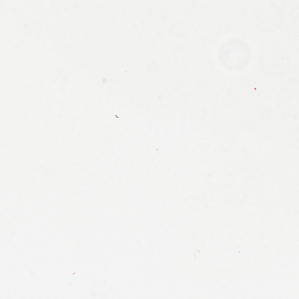

In [29]:
tiles_mag[72]

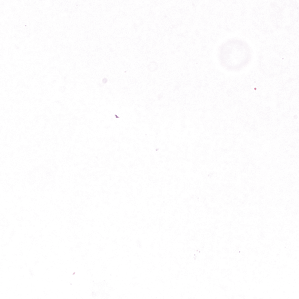

In [30]:
tile_np = np.array(tiles_mag[72].convert('RGB'))
tile_std = LumStd.standardize_tile(tile_np)
tile_norm = normaliser.transform_tile(tile_std)
Image.fromarray(tile_norm)

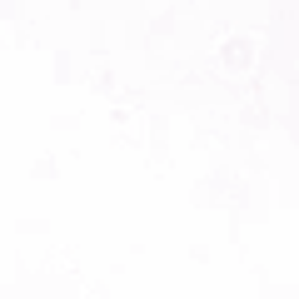

In [31]:
tiles_small_og[72].resize((299,299), Image.BICUBIC)

In [32]:
tgen_small = tile_gen(he_norm_small, 299)

In [33]:
next(tgen_small)

(9, 6)

## Testing tile output

In [116]:
def save_train_tiles(path, tile_gen, cancer_mask, tissue_mask, standardiser, prefix = ''):
    os.makedirs(TILES_PATH.joinpath('cancer'), exist_ok = True)
    os.makedirs(TILES_PATH.joinpath('non-cancer'), exist_ok = True)
    x_tiles, y_tiles = next(tile_gen)
    verbose_print('Whole Image Size is {0} x {1}'.format(x_tiles, y_tiles))
    i = 0 
    for tile in tile_gen:
        img = tile.convert('RGB')
        ###
        img_np = np.array(img)
        img_std = standardiser.standardize_tile(img_np)
        img_norm = Image.fromarray(normaliser.transform_tile(img_std))
        ###
        #Name tile as horizontal position _ vertical position starting at (0,0)
        tile_name = prefix + str(np.floor_divide(i,x_tiles)) + '_' +  str(i%x_tiles) 
        if cancer_mask.ravel()[i] == 0:
            img_norm.save(path.joinpath('cancer', tile_name + '.jpeg'), 'JPEG')
        elif tissue_mask.ravel()[i] == 0:
            img_norm.save(path.joinpath('non-cancer', tile_name + '.jpeg'), 'JPEG')
        i += 1
    verbose_print('Exported tiles for {0}'.format(prefix))

In [128]:
tgen = tile_gen_at_mag(he_slide, ALIGNMENT_MAG, 299)

In [130]:
wsi_tile_size

(18, 13)

In [131]:
c_mask_filtered = np.zeros(wsi_tile_size)
t_mask = np.zeros(wsi_tile_size)

In [132]:
TILES_PATH = OUTPUT_PATH.joinpath('tiles_2x')

In [133]:
LumStd = LuminosityStandardizer()
LumStd.fit(np.array(he.convert('RGB')))
normaliser.precompute(np.array(he_std))
tgen = tile_gen_at_mag(he_slide, ALIGNMENT_MAG, 299)
save_train_tiles(TILES_PATH, tgen, c_mask_filtered, t_mask, LumStd, prefix = PREFIX)

Whole Image Size is 18 x 13
Exported tiles for 1820_N_10545A_4_


In [147]:
LumStd.fit(np.zeros((10,10,3)).astype(np.uint8))

In [143]:
LumStd.p

0.0

In [149]:
normaliser.maxC_source

array([[0., 0.]])

In [148]:
normaliser.precompute(np.ones((10,10,3)).astype(np.uint8))